In [ ]:
%load_ext autoreload
%autoreload 2

### Try TemporalFusionTransformer
* Read: https://towardsdatascience.com/temporal-fusion-transformer-a-primer-on-deep-forecasting-in-python-4eb37f3f3594

In [8]:
import warnings
warnings.filterwarnings('ignore')

import os
import sys

import pandas as pd
import numpy as np
import torch
import pytorch_lightning as pl
from pytorch_lightning.callbacks import EarlyStopping, LearningRateMonitor, ModelCheckpoint
from pytorch_forecasting import TimeSeriesDataSet, TemporalFusionTransformer
from pytorch_forecasting.data import GroupNormalizer
from pytorch_forecasting.metrics import QuantileLoss
from pytorch_lightning.loggers import WandbLogger


DIR_PROJECT = '/media/user/12TB1/HanLi/GitHub/CMU11785-project/'
sys.path.append(os.path.join(DIR_PROJECT, 'src'))
sys.path.append(os.path.join(DIR_PROJECT, 'utils'))
DIR_TRAINED = os.path.join(DIR_PROJECT, 'local_trained')

from criterions import Pearson

DIR_DATA = os.path.join(DIR_PROJECT, 'local_data')
NUM_WORKERS = 8 # Use 4 for AWS


# Baseline hyperparameters: 
# TFT_quantile_loss_tune_10
# https://wandb.ai/11785_project/11785_project_tuning
args = {
    # ------------------------------
    # Basic config
    'random_seed': 11785,
    'n_samples': 1000,
    'batch_size': 64,
    'n_workers' : NUM_WORKERS,
    'criterion': {
        'quantile': QuantileLoss(),
        'pearson': Pearson.Pearson(),   # Miao's implementation
        'other': None,                  # TODO: check out other loss (e.g., MSE)
    },
    # ------------------------------
    # Hyperparameters
    'lr_s': 7e-3,
    'hidden_size': 512,
    'attention_head_size': 2,        # use multihead for large hidden size
    'dropout': 0.1,
    'hidden_continuous_size': 4,     # set to <= hidden_size
    'output_size': 7,                # 7 quantiles for QuantileLoss by default
    'reduce_on_plateau_patience': 4, # reduce learning rate if no improvement in validation loss after x epochs
    'gradient_clip_val': 0.1,
    # ------------------------------
    # Logging
    'log_interval': 5,               # log every n batches, set to None when try to find best lr
    'wandb_entity': '11785_project',
    'wandb_project': '11785_project_tuning',
    'wandb_name': 'TFT_baseline_0426',
}

### Create dataset and dataloaders

In [ ]:
# load data, create validation and training dataset
dir_pf_dataset = os.path.join(DIR_DATA, 'pf_dataset_tft')
n = args['n_samples']

train_dataset = TimeSeriesDataSet.load(os.path.join(dir_pf_dataset, f'pf_train_{n}_samples.pf'))
val_dataset = TimeSeriesDataSet.load(os.path.join(dir_pf_dataset, f'pf_val_{n}_samples.pf'))
test_dataset = TimeSeriesDataSet.load(os.path.join(dir_pf_dataset, f'pf_test_{n}_samples.pf'))

# create dataloaders for model
train_dataloader = train_dataset.to_dataloader(train=True, batch_size=args['batch_size'], num_workers=args['n_workers'])
val_dataloader = val_dataset.to_dataloader(train=False, batch_size=args['batch_size'], num_workers=args['n_workers'])
test_dataloader = test_dataset.to_dataloader(train=False, batch_size=args['batch_size'], num_workers=args['n_workers'])

print("Load existing datasets completed:")
print(f"Train dataset:  pf_train_{n}_samples.pf")
print(f"Val dataset:    pf_val_{n}_samples.pf")
print(f"Test dataset:   pf_test_{n}_samples.pf")

### Configure network and trainer

#### Find best LR

In [ ]:
if args['random_seed'] is not None: pl.seed_everything(args['random_seed'])
trainer = pl.Trainer(
    gpus=1,
    gradient_clip_val=args['gradient_clip_val'],
)

tft_model = TemporalFusionTransformer.from_dataset(
    train_dataset,
    learning_rate=args['lr_s'],
    hidden_size=args['hidden_size'],  # most important hyperparameter apart from learning rate
    attention_head_size=args['attention_head_size'], # number of attention heads. Set to up to 4 for large datasets
    dropout=args['dropout'],  # between 0.1 and 0.3 are good values
    hidden_continuous_size=args['hidden_continuous_size'],
    output_size=args['output_size'],
    loss=args['criterion']['quantile'],
    # loss=args['criterion']['pearson'],
    log_interval=args['log_interval'],  # uncomment for learning rate finder and otherwise, e.g. to 10 for logging every 10 batches
    reduce_on_plateau_patience=args['reduce_on_plateau_patience'], # reduce learning rate if no improvement in validation loss after x epochs
)

print(f"Number of parameters in network: {tft_model.size()/1e3:.1f}k")

# # find optimal learning rate
# res = trainer.tuner.lr_find(
#     tft_model,
#     train_dataloaders=train_dataloader,
#     val_dataloaders=val_dataloader,
#     max_lr=10.0,
#     min_lr=1e-6,
# )

# print(f"suggested learning rate: {res.suggestion()}")
# fig = res.plot(show=True, suggest=True)
# fig.show()

#### Create model and train

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: tsbyq_wb (use `wandb login --relogin` to force relogin)


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]

   | Name                               | Type                            | Params
----------------------------------------------------------------------------------------
0  | loss                               | QuantileLoss                    | 0     
1  | logging_metrics                    | ModuleList                      | 0     
2  | input_embeddings                   | MultiEmbedding                  | 77.0 K
3  | prescalers                         | ModuleDict                      | 2.4 K 
4  | static_variable_selection          | VariableSelectionNetwork        | 25.2 K
5  | encoder_variable_selection         | VariableSelectionNetwork        | 3.1 M 
6  | decoder_variable_selection         | VariableSelectionNetwork        | 3.1 M 
7  | static_context_variable_selection  | GatedResidualNe

Epoch 19: 100%|██████████| 46/46 [20:56<00:00, 27.31s/it, loss=0.12, v_num=bi6p, train_loss_step=0.115, val_loss=0.154, train_loss_epoch=0.121]     


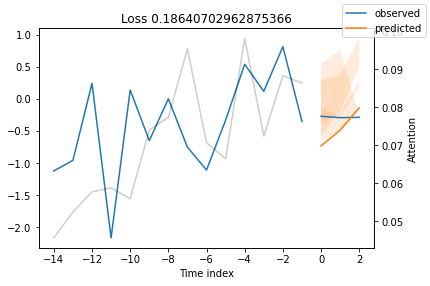

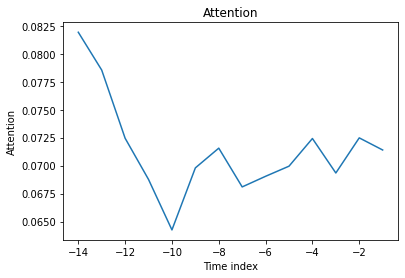

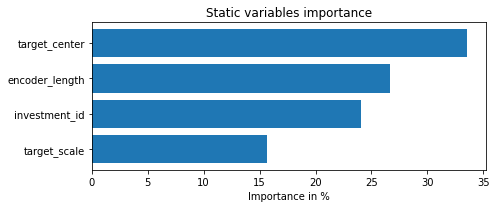

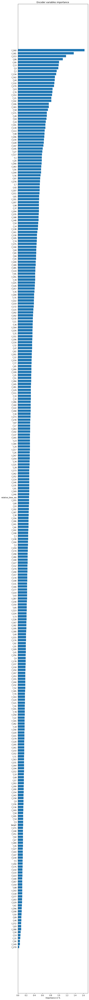

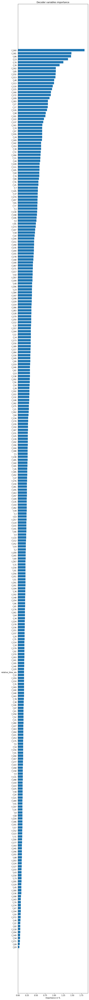

...

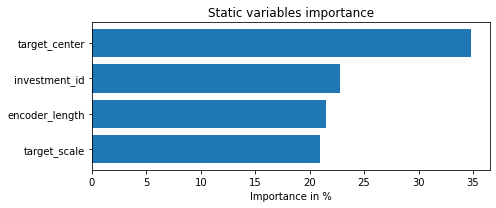

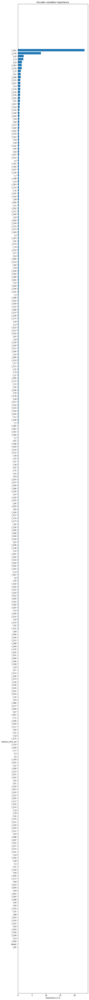

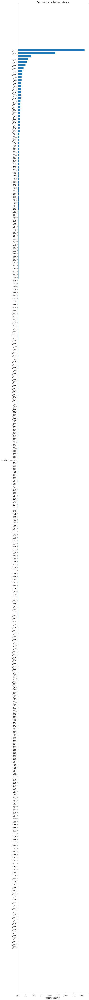

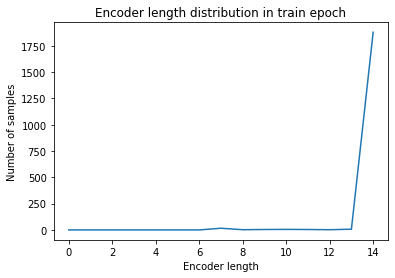

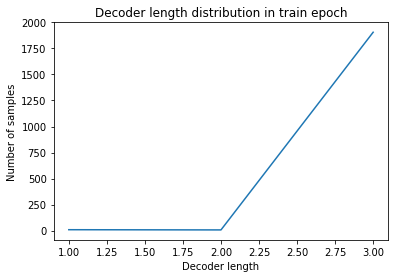

In [5]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1e-4, patience=10, verbose=False, mode="min")
lr_logger = LearningRateMonitor()  # log the learning rate

checkpoint_callback = ModelCheckpoint(
    monitor='val_SMAPE', 
    dirpath='/media/user/12TB1/HanLi/GitHub/CMU11785-project/logs/model_checkpoints/', 
    save_top_k=2, 
    filename='500-default-{epoch:02d}-{val_SMAPE:.2f}'
)

logger = WandbLogger(
    entity="11785_project",
    project="11785_project_tuning",
    name='TFT_baseline',
    log_model=True
)


trainer = pl.Trainer(
    max_epochs=20,
    gpus=1,
    weights_summary="top",
    gradient_clip_val=0.1,
    limit_train_batches=30,  # coment in for training, running valiation every 30 batches
    # fast_dev_run=True,  # comment in to check that networkor dataset has no serious bugs
    callbacks=[lr_logger, early_stop_callback, checkpoint_callback],
    logger=logger,
)


tft_model = TemporalFusionTransformer.from_dataset(
    train_dataset,
    learning_rate=args['lr_s'],
    hidden_size=args['hidden_size'],  # most important hyperparameter apart from learning rate
    attention_head_size=args['attention_head_size'], # number of attention heads. Set to up to 4 for large datasets
    dropout=args['dropout'],  # between 0.1 and 0.3 are good values
    hidden_continuous_size=args['hidden_continuous_size'],
    output_size=args['output_size'],
    loss=args['criterion']['quantile'],
    # loss=args['criterion']['pearson'],
    log_interval=args['log_interval'],  # uncomment for learning rate finder and otherwise, e.g. to 10 for logging every 10 batches
    reduce_on_plateau_patience=args['reduce_on_plateau_patience'], # reduce learning rate if no improvement in validation loss after x epochs
)

# fit network
trainer.fit(
    tft_model,
    train_dataloaders=train_dataloader,
    val_dataloaders=val_dataloader,
)
torch.save(tft_model.state_dict(), os.path.join(DIR_TRAINED, 'tft_baseline.pth'))

In [10]:
s_model = TemporalFusionTransformer.from_dataset(
    train_dataset,
    learning_rate=args['lr_s'],
    hidden_size=args['hidden_size'],  # most important hyperparameter apart from learning rate
    attention_head_size=args['attention_head_size'], # number of attention heads. Set to up to 4 for large datasets
    dropout=args['dropout'],  # between 0.1 and 0.3 are good values
    hidden_continuous_size=args['hidden_continuous_size'],
    output_size=args['output_size'],
    loss=args['criterion']['quantile'],
    # loss=args['criterion']['pearson'],
    log_interval=args['log_interval'],  # uncomment for learning rate finder and otherwise, e.g. to 10 for logging every 10 batches
    reduce_on_plateau_patience=args['reduce_on_plateau_patience'], # reduce learning rate if no improvement in validation loss after x epochs
)

s_model.load_state_dict(torch.load(DIR_TRAINED, 'tft_baseline.pth'))
s_model.eval()

IsADirectoryError: [Errno 21] Is a directory: '/media/user/12TB1/HanLi/GitHub/CMU11785-project/local_trained'

In [ ]:
import torch
torch.cuda.empty()

### Test model on the test dataset

In [ ]:
test_results = trainer.test(tft_model, dataloaders=test_dataloader)